<h1><center>Vaccination Drives and the Inequalities Underneath</center></h1>
<h4><center>
<a style="text-decoration:none" href="https://github.com/eshan-rg">Eshan Gujarathi</a>, IIT Gandhinagar, <a style="text-decoration:none" href="mailto:<author1>@iitgn.ac.in">eshan.rg@iitgn.ac.in</a>
<br><br>
<a style="text-decoration:none" href="https://github.com/HitarthGandhi">Hitarth Gandhi</a>, IIT Gandhinagar, <a style="text-decoration:none" href="mailto:<author2>@iitgn.ac.in">hitarth.g@iitgn.ac.in</a>
<br><br>
<a style="text-decoration:none" href="https://github.com/Vishal1309">Vishal Soni</a>, IIT Gandhinagar, <a style="text-decoration:none" href="mailto:<author3>@iitgn.ac.in">jayesh.s@iitgn.ac.in</a>
</center></h4>

<center><a href="https://github.com/CS328-Spring-2022/writing-assignment-vishal_eshan_hitarth"><img src="https://img.shields.io/badge/Github-Writing%20Assignment-brightgreen" alt="Repo"></a></center>

# Covid Vaccination Drive Analysis and the Inequalities Underneath

### Introduction

The Covid-19 pandemic, of which we are all too aware, has had a devastating impact on the world in recent years. It is much more than just a health threat and has affected each individual in some way or the other. With lockdowns and emergencies in all parts of the world, it has changed the way everything used to function. The economic and social disruption caused by the pandemic is huge, and has caused crisis even in well developed countries. Millions of people lost their job, and are at risk of extreme poverty. Lot of enterprises reached a state of existential threat. But all of this can be improved in the future. Something we cannot change is the dramatic loss of human life worldwide and the effect it has had on the health of people. 

The best way to really understand how the coronavirus pandemic has affected the world is using statistics. Let us first start with analyzing its spread and the number of deaths it caused.

### Analysis of the Covid Spread around the world

In [1]:
from IPython.display import HTML
HTML('''<button type="button" class="btn btn-outline-danger"  onclick="codeToggle();">Toggle Code</button>''')

In [2]:
# Importing the libraries needed
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from ipywidgets import widgets, interactive
import plotly.io as pio
import plotly.express as px
import warnings
warnings.filterwarnings('ignore')
pio.renderers.default='notebook'
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)

In [3]:
# Reading the data
covid_df = pd.read_csv("./data/owid-covid-data.csv.gz", compression="gzip")

A lot of data in the dataset is missing, and thus we drop the rows which have missing data in the necessary columns.

**Note:** Interpolation techniques cannot be used here to fill the missing data since interpolating features like 'iso_code', 'location', 'continent', and 'date' does not make sense.

In [4]:
required_columns = ["iso_code", "location", "continent", "date"]
covid_df = covid_df.dropna(subset = required_columns)

Following is the visualization of the data. Some of the relavant columns in our data for each country include:
- Total number of cases till date
- New cases on that day
- Total deaths till date
- New deaths on that day
- Patients admitted to hostipal
- Patients admitted to ICU
- Population and population Density

In [5]:
# Visualizing the data
cols = ['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases', 'total_deaths', 'new_deaths', 'total_cases_per_million', 'new_cases_per_million', 'total_deaths_per_million', 'new_deaths_per_million']
covid_df[cols].fillna(0).sample(5)

,iso_code,continent,location,date,total_cases,new_cases,total_deaths,new_deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million
13841,BRB,North America,Barbados,2021-08-11,4496.0,11.0,48.0,0.0,15626.955,38.233,166.836,0.000
71038,IDN,Asia,Indonesia,2022-01-21,4280248.0,2604.0,144201.0,2.0,15487.843,9.422,521.783,0.007
120408,PHL,Asia,Philippines,2021-10-02,2580173.0,14686.0,38656.0,163.0,23234.982,132.250,348.105,1.468
80153,KEN,Africa,Kenya,2021-09-27,248515.0,54.0,5109.0,7.0,4519.629,0.982,92.915,0.127
96076,MHL,Oceania,Marshall Islands,2021-03-18,4.0,0.0,0.0,0.0,67.094,0.000,0.000,0.000


#### The spread of cases around the world

The following plot denotes the number of 'new cases' in a day. We can move on the slider timeline bar to get the plot for a particular day.

If you check for around April 2021, we observe that India has the most rise in cases. This was the time India was going through the second wave of the pandemic, and thus we had most new cases in a day.

In [6]:
# Plotting interactive graph for new covid cases worldwide
tmp_df = covid_df.dropna(subset=['new_cases_smoothed'])
fig = px.scatter_geo(tmp_df, locations="iso_code", color="continent",
                     hover_name="location", size="new_cases_smoothed",
                     projection="natural earth", animation_frame="date", template="seaborn")

fig.show()

The next plot shows the 'total number of cases' with time for each country. We can move on the slider timeline bar to see the rise of cases around the world.

In [ ]:
# Plotting interactive graph for total covid cases worldwide
tmp_df = covid_df.dropna(subset=['total_cases'])
fig = px.scatter_geo(tmp_df, locations="iso_code", color="continent",
                     hover_name="location", size="total_cases",
                     projection="natural earth", animation_frame="date", template="seaborn")

fig.show()

#### Effect of Covid-19 in terms of human loss

Now let us visualize the number of deaths due to Covid-19.

We first drop the rows which have missing data in the relevant coulumns.

In [ ]:
cols = ['location', 'total_deaths_per_million', 'continent', 'total_deaths']
df = covid_df.dropna(subset = cols)
countries = ['India', 'Georgia', 'Brazil', 'United States', 'Chad', 'Canada', 'Germany', 'Italy', 'Japan', 'China']
df_country = df[df['location'].isin(countries)]
df.sample(5)

,Unnamed: 0,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,...,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
53975,53975,FRA,Europe,France,2020-08-21,274050.0,4954.0,3211.286,30509.0,24.0,...,30.1,35.6,NaN,5.98,82.66,0.901,NaN,NaN,NaN,NaN
120347,120347,PHL,Asia,Philippines,2021-08-02,1605762.0,8073.0,7195.143,28093.0,77.0,...,7.8,40.8,78.463,1.00,71.23,0.718,NaN,NaN,NaN,NaN
94710,94710,MLI,Africa,Mali,2020-10-26,3499.0,9.0,13.143,133.0,1.0,...,1.6,23.0,52.232,0.10,59.31,0.434,NaN,NaN,NaN,NaN
40783,40783,DNK,Europe,Denmark,2020-11-16,63331.0,1195.0,1062.714,764.0,4.0,...,19.3,18.8,NaN,2.50,80.90,0.940,NaN,NaN,NaN,NaN
44787,44787,EGY,Africa,Egypt,2021-11-07,337485.0,903.0,924.000,19076.0,65.0,...,0.2,50.1,89.827,1.60,71.99,0.707,NaN,NaN,NaN,NaN


The following plot shows the total number of deaths for some of the countries with time. The x-axis represents the date and the y-axis represents the number of deaths.

We can choose to visualize the plot for a particular country by double clicking on that country. We can add the plots for countries to compare with a single click on the country we wish to add. Now if we want to go back and visualize plots for all countries, we can double click on any unselected country.

We can also hover on the graph to get the exact number of deaths of a particular country till that date.

In [ ]:
# Total Deaths for each country
fig = px.line(df_country, x="date", y="total_deaths", title='Total Deaths', hover_name='location', color='location')
fig.show()

Does the above plot mean that US, Brazil, and India are the worst affected countries due to Covid? No! This is because each country has different population and thus we should not compare them with the total deaths. One possible solution would be to compare the deaths per million. To understand it better and prove the above, we can take a simple example.

Below is a similar plot, but here, instead of the total deaths, we have the plot for total deaths per million. If you select India and Georgia in the above plot, we can see that the total deaths in India (514k) is a lot more than that of Georgia (16k). Now, select the same two countries in the below plot. The total deaths per millions for India as observed is around 350, but on the other hand, the total deaths per million for Georgia is around 4000!

This is a big misconception that a lot of poeple have, and thus small contries like Georgia don't make it to the news even if they are more severely affected, and don't get the attention and help they should. 

In [ ]:
# Total Deaths per million for all countries
fig = px.line(df_country, x="date", y="total_deaths_per_million", title='Total Deaths per million', hover_name='location', color='location')
fig.show()

To get a better insight, we should view the statistics for each continent separately as each of them have different resources. Below is the plot for the top 5 countries in Asia with the most and least deaths.

We can give other continents as input in the python function defined below to view the statistics of that continent.

In [ ]:
def death_per_continent(df, continent, top=5, bottom=5):
    df_continent = df[df['continent']==continent]
    df_continent = df_continent.sort_values('total_deaths_per_million', ascending=False)
    df_continent[['location', 'date', 'total_deaths_per_million']]
    locs = list(df_continent.location.unique()[:top]) 
    locs += list(df_continent.location.unique()[-bottom:])
    df_continent = df_continent[df_continent['location'].isin(locs)]
    fig = px.line(df_continent, x="date", y="total_deaths_per_million", title=f'Total Deaths Per Million in {continent}', hover_name='location', color='location')
    return fig

continent = covid_df.continent.unique()

In [ ]:
fig = death_per_continent(df, continent[0])
fig.show()

## Covid Vaccination Analysis:

### Introduction:

To bring this long running pandemic to an end, an efficient and inclusive distribution of covid-19 vaccines could be our next most prospective step. If order to take action along these lines, we first need to understand how the current covid vaccination drives are runnning. If we are to interpret this data, we will be able to identify any underlying inequalities that might be happening during the distribution of covid vaccinations. So, our task is to understand covid-19 vaccinations data worldwide and draw inferences from the same to understand how covid-19 vaccination drives are going. We also plan to understand the underlying inequalities across the world.

### Covid Vaccine Distribution

As mentioned, let us compare the distribution of Covid-19 vaccines in different countries. For better understanding the inequalities in the distribution, we compare the statistics for 3 countries, Canada, India, and Chad. Canada is a developed country, India is a developing country, and Chad is an under-developed country.

In each plot, we show three trends, distribution of first dose, second dose and the booster dose. For comparing the three, we have plotted the percentage of poeple in the country who have received the doses. We can hover on the plots to see the percentage of vaccinated people at a particular point of time.

Below, we have also created a custom python function in which we can input the country for which we need to see the trends.

In [ ]:
def vacc_by_country(df, country):
    df_country = df[df['location']==country]
    fig = px.line(df_country, x='date', y=['people_vaccinated_per_hundred','people_fully_vaccinated_per_hundred','total_boosters_per_hundred'], title = f'% of people vaccinated in {country}')
    return fig

In [ ]:
# Removing rows with missing data in relevant columns
cols = ['date','location','people_vaccinated_per_hundred']
covid_df = covid_df.dropna(subset = cols)

In [ ]:
fig = vacc_by_country(covid_df, 'Canada')
fig.show()

In [ ]:
fig = vacc_by_country(covid_df, 'India')
fig.show()

In [ ]:
fig = vacc_by_country(covid_df, 'Chad')
fig.show()

We can clearly observe that Canada is the most vaccinated country with around 81% of people doubly vaccinated, and also the trends show that vaccination drive was organized in a planned manner. This shows that developed countries were able to vaccinate a majority of their population in a short span of time. The vaccination drive for booster dose started quite early in the developing countries and can be seen from the line plots.

In India, around 57% of the population is fully vaccinated. It is evident from the curve of the graph that developing countries like India took a lot of time to complete their vaccination drives whereas developed countries have a steep vaccination curve. Moreover, the vaccination drive in India started a couple of months after the one started in Canada, this adds to the delayed vaccination drive in India for the booster dose.

Underdeveloped countries like Chad are in a very bad situation with only 1% of poeple fully vaccinated and the drive for booster dose not even started. Such countries need a lot of attention and help as they have a weak economy and lack the resources needed to carry out planned vaccination drives.

### Covid Vaccinations by different manufacturers

Now let us have a look at how there was a rise in the number of doses of different vaccines in various countries. The type of vaccine and thus the manufacturer played an important role in the vaccination drives due to their cost and success rate.

First we import the data. The data contains the number of total doses of different vaccines with time in each country.

In [ ]:
# Importing the data
v_by_manu = pd.read_csv("./data/vaccinations/vaccinations-by-manufacturer.csv")
v_by_manu.sample(10)

,location,date,vaccine,total_vaccinations
19073,Luxembourg,2022-02-11,Pfizer/BioNTech,692179
29082,Ukraine,2022-01-01,Sinovac,9257611
19384,Nepal,2022-02-25,Sinopharm/Beijing,19129925
30274,United States,2021-12-19,Moderna,189052448
8202,Ecuador,2021-09-14,Sinovac,12119590
27228,Switzerland,2021-09-02,Moderna,6413651
1916,Argentina,2021-12-01,Moderna,3537537
11125,Germany,2021-02-07,Novavax,0
4116,Chile,2021-08-08,Oxford/AstraZeneca,466553
12621,Germany,2021-12-03,Oxford/AstraZeneca,12735894


Following is the plot for the country Argentina. The x-axis represents the time series and the y-axis contains the number of total doses of that particular vaccine. We can observe how certain vaccines saw a sudden rise in their production.

Text(0.5, 1.0, 'Argentina')

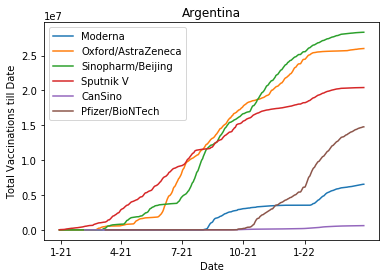

In [ ]:
j="Argentina"
v_arg=v_by_manu[v_by_manu["location"]==j]
for i in v_arg["vaccine"].unique():
    v_arg_spu=v_arg[v_arg["vaccine"]==i]
    plt.plot(v_arg_spu["date"],v_arg_spu["total_vaccinations"], label=i)
x_ticks = ["2021-01-01", "2021-04-01", "2021-07-01", "2021-10-01", "2022-01-01"]
x_labels = ['1-21', '4-21', '7-21', '10-21', '1-22'] 
plt.xticks(ticks=x_ticks, labels=x_labels)
plt.legend()
plt.xlabel('Date')
plt.ylabel('Total Vaccinations till Date')
plt.title(j)

We can also create a interactive plot in the following way. When run in python, this gives us a dropdown to select the country for which we need to analyse the number of doses of different vaccines used in that country.

In [ ]:
area = widgets.Dropdown(
    options=v_by_manu["location"].unique(),
    value='Argentina',
    description='Country',
)

def plotit(area):
    v_arg=v_by_manu[v_by_manu["location"]==area]
    x_ticks = [v_arg["date"].min(),v_arg["date"].max()]
    for i in v_arg["vaccine"].unique():
        v_arg_spu=v_arg[v_arg["vaccine"]==i]
        plt.plot(v_arg_spu["date"],v_arg_spu["total_vaccinations"], label=i)
    x_labels = x_ticks
    plt.xticks(ticks=x_ticks, labels=x_labels)
    plt.legend()
    plt.xlabel('Date')
    plt.ylabel('Total Vaccinations till Date')
    plt.title(area)

interactive(plotit, area=area)

interactive(children=(Dropdown(description='Country', options=('Argentina', 'Austria', 'Belgium', 'Bulgaria', …

##### Further plan

In the final submission, we plan to include the analysis of more features like hospital and ICU admissions, and also make inferences based on birth rate and GDP. We will also provide more statistics related to vaccination drives and find out the most and least vaccinated countries, and also the factors behind the same. This will give us a better insight into the inequalities amongst countries during the pandemic.

In [36]:
cols = ['iso_code', 'location', 'continent', 'gdp_per_capita', 'people_fully_vaccinated_per_hundred']
df1 = covid_df[covid_df['date'] == '2021-09-12'][cols]
df1.isna().sum()/df1.shape[0]
df1 = df1.dropna(axis=0)

In [35]:
fig = px.scatter(df1, x='gdp_per_capita', y='people_fully_vaccinated_per_hundred', color='continent', hover_name='location', trendline='lowess', trendline_scope="overall", trendline_color_override="black")
fig.show()

* Africa has relatively low GDP and also has very low number of people vaccinated.
* Asia on the other hand, despite having many countries with low GDP, has very high vaccination.
* Countries having very high GDP have very good vaccintion as expected.

### HDI vs vaccination

In [25]:
cols = ['iso_code', 'location', 'continent', 'human_development_index', 'people_fully_vaccinated_per_hundred']
df = covid_df[covid_df['date'] == '2021-09-12'][cols]
df.isna().sum()/df.shape[0]
df = df.dropna(axis=0)

In [31]:
fig = px.scatter(df, x='human_development_index', y='people_fully_vaccinated_per_hundred', color='continent', hover_name='location', trendline='lowess', trendline_scope="overall",trendline_color_override="black")
fig.show()

In [69]:
cols = ['iso_code', 'location', 'continent', 'date', 'total_deaths_per_million', 'total_cases_per_million', 'human_development_index', 'gdp_per_capita']
countries = ['Canada', 'India', 'Chad']
# df2 = covid_df[covid_df['location'].isin(countries)][cols]
df2 = covid_df[covid_df['date'] == '2020-05-15'][cols]
df2.isna().sum()/df2.shape[0]
df2 = df2.dropna(axis=0)

In [70]:
df2['deaths_by_cases'] = df2['total_deaths_per_million']*100/df2['total_cases_per_million']

In [71]:
df2.sample(5)

,iso_code,location,continent,date,total_deaths_per_million,total_cases_per_million,human_development_index,gdp_per_capita,deaths_by_cases
3758,AGO,Angola,Africa,2020-05-15,0.059,1.415,0.581,5819.495,4.169611
121453,PRT,Portugal,Europe,2020-05-15,117.035,2811.095,0.864,27936.896,4.163324
20621,BWA,Botswana,Africa,2020-05-15,0.417,10.012,0.735,15807.374,4.165002
94546,MLI,Mali,Africa,2020-05-15,2.206,38.646,0.434,2014.306,5.708223
140099,SSD,South Sudan,Africa,2020-05-15,0.351,20.736,0.433,1569.888,1.692708


In [74]:
fig = px.scatter(df2, x='gdp_per_capita', y='deaths_by_cases', color='location', hover_name='location')
fig.show()